# Mathematical Modeling Project Work
### Tamás Gyenis 2023 January

## 1. Introduction
This notebook aims to present the data exploration and modeling process for a public Kaggle dataset, <a href="https://www.kaggle.com/datasets/jacklacey/left-4-dead-2-20000-player-stats">*Left 4 Dead 2 20,000+ Player's Statistics*</a>. The dataset has more than 20k records of player's performances and behaviour in a shooting type video game. The data was collected from public sources and stored in a structured relational database, saved in a csv file. In this project I try to predict how much time a player has spent playing the game from their in-game performance. Also, I try to estimate which difficulty is set for a player based on the same features. I chose both a regression and a classification task to have the opportunity to practice both of those modeling types. The goal is to get better performance than naive regression and classification models. We have to mention, that no previous modeling has been done on the dataset, so achievable model performances are unknown.

## 2. Feature Extraction
In order to be able to analyze the dataset better and prepare it for modeling, we need some feature engineering first. In this section I describe the available features and I also construct some potentially useful ones.

In [97]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import os

import tqdm

from common import *
from models import *

In [98]:
# we use plotly, for easier documentation later: I can zoom, crop etc. Some styling.
px.defaults.template = 'plotly_dark'

In [99]:
# load data
raw_data_path = 'C:/Dev/ELTE_AI/mat_mod/data/l4d2_player_stats_final.csv'

# I like to save an original copy of the dataset before any modification, so we can retrieve information more easily
df_original = pd.read_csv(raw_data_path)
df = df_original.copy(deep=True)

In [100]:
df.head(5)

,Username,Playtime_(Hours),Pistol_Shots,Pistol_Kills,Pistol_Usage,Magnum_Shots,Magnum_Kills,Magnum_Usage,Uzi_Shots,Uzi_Kills,...,Knife_Usage,Molotovs_Thrown,Molotov_Kills,Pipe_Bombs_Thrown,Pipe_Bomb_Kills,Bile_Jars_Thrown,Bile_Jar_Hits,Most_Friendly_Fire,Difficulty,Average_Friendly_Fire
0,0,2433.577222,94665.0,10470.0,2.77,121222.0,27056.0,7.16,44666.0,5165.0,...,0.47,11166.0,99278.0,5817.0,23433.0,5802.0,12863.0,13653.0,Normal,142.0
1,1,121.879444,9136.0,1371.0,1.47,14928.0,6802.0,7.30,997.0,187.0,...,0.03,788.0,10141.0,977.0,6962.0,519.0,1557.0,1914.0,Expert,89.0
2,2,69.955278,4100.0,693.0,4.87,222.0,133.0,0.93,2834.0,271.0,...,0.00,23.0,130.0,445.0,1202.0,44.0,83.0,3195.0,Expert,58.0
3,3,48.421667,7369.0,1208.0,5.99,784.0,250.0,1.24,3322.0,496.0,...,0.00,135.0,1090.0,105.0,716.0,48.0,75.0,1412.0,Expert,76.0
4,4,307.639722,51944.0,9481.0,8.93,20545.0,6813.0,6.42,38224.0,5493.0,...,0.00,613.0,4797.0,515.0,4195.0,272.0,424.0,10851.0,Expert,112.0


Let's convert column names to camel case. Also, we should convert the only string column 'Difficulty' to numerical.

In [101]:
# convert column names to snake case
df.rename(columns={col: col.lower().replace('-', '_') for col in df.columns}, inplace=True)
df.rename(columns={'playtime_(hours)': 'playtime'}, inplace=True)

# convert difficulty from string to numeric
difficulty_map = {'Easy': 0,
                  'Normal': 1,
                  'Advanced': 2,
                  'Expert': 3}

df['difficulty'] = df['difficulty'].map(difficulty_map)

In [102]:
df.describe()

,username,playtime,pistol_shots,pistol_kills,pistol_usage,magnum_shots,magnum_kills,magnum_usage,uzi_shots,uzi_kills,...,knife_usage,molotovs_thrown,molotov_kills,pipe_bombs_thrown,pipe_bomb_kills,bile_jars_thrown,bile_jar_hits,most_friendly_fire,difficulty,average_friendly_fire
count,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,...,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,20830.000000,2.083000e+04,20830.000000,20830.000000
mean,10414.500000,104.684003,12389.739558,2031.092127,8.035493,4948.215218,1984.546471,5.151902,7227.586990,1274.591119,...,0.050348,248.814546,2000.592751,255.532117,1799.752184,120.713778,179.056313,4.976528e+04,1.773932,81.363946
std,6013.247389,1974.873029,24198.764272,3944.710074,6.324443,16679.459523,8250.642273,5.586247,20501.115475,3779.680779,...,0.302169,1333.472437,10028.704910,924.607365,6059.289202,586.911986,873.542727,6.928768e+06,1.007877,879.579826
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000
25%,5207.250000,19.027153,3336.500000,519.000000,4.800000,522.000000,164.000000,1.580000,1204.000000,195.000000,...,0.000000,33.000000,237.000000,43.000000,286.000000,15.000000,22.000000,3.010000e+02,1.000000,35.000000
50%,10414.500000,36.110417,6568.000000,1060.000000,6.680000,1462.000000,502.000000,3.540000,2923.500000,506.000000,...,0.000000,75.000000,583.000000,95.000000,658.000000,36.000000,58.000000,7.050000e+02,2.000000,55.000000
75%,15621.750000,73.698333,12966.750000,2153.000000,9.470000,3918.000000,1446.000000,6.807500,6364.250000,1146.750000,...,0.000000,175.000000,1388.750000,210.750000,1457.000000,86.000000,137.000000,1.441000e+03,3.000000,88.000000
max,20829.000000,277827.960278,608711.000000,131565.000000,100.000000,627966.000000,411640.000000,100.000000,731767.000000,152921.000000,...,21.320000,125856.000000,635486.000000,55566.000000,249158.000000,41774.000000,87673.000000,1.000000e+09,3.000000,121347.000000


We can see that most of the 113 columns are very similar: player statistic with a given weapon. The *usage* is a ratio of how much a weapon is being used by a player during playtime. The *shots* describe the number of trigger pulls with the weapon and the *kills* the number of successfully takedowns. The weapons though, can be separated to two categories: actual weapons that the player can equip and use, like *uzi* or *knife* and utility weapons that can be thrown like *molotov* or *bile_jar*. We should treat these features differently. Also, there are some columns that don't describe weapon performances like *average_friendly_fire*, *playtime* or *username*. These will be called meta columns. Now let's separate the different feature types and the columns belonging to them.

In [103]:
weapon_names = [col.split('_shots')[0] for col in df.columns if 'shots' in col]
utility_names = [utility_name.split('_thrown')[0] for utility_name in df.columns if 'thrown' in utility_name]
meta_names = ['username', 'playtime', 'difficulty', 'average_friendly_fire']

In [104]:
# pltiing the sum usage of weapons
sum_weapon_usage = df[[col for col in df.columns if 'usage' in col]].sum(axis=0).sort_values(ascending=False)
px.bar(sum_weapon_usage).update_layout(
    xaxis_title='weapon', yaxis_title='sum usage', title='usage of different weapons')

If we plot the sum of usages of all the samples for the different weapons we can see which are the most popular ones. Also, we can see that some weapons are hardly used. After checking why, I found out that these were added to the game later, so players didn't have a chance to use them. We should exclude these from the dataset.

In [105]:
weapons_with_high_usage = [name.split('_')[0] for name in sum_weapon_usage.index[:17]]
weapons_with_high_usage

['ak',
 'assault',
 'pistol',
 'combat',
 'desert',
 'tactical',
 'military',
 'magnum',
 'katana',
 'silenced',
 'uzi',
 'fire',
 'chrome',
 'pump',
 'hunting',
 'chainsaw',
 'machete']

In [106]:
# separate these to a  dataframe
df_weapons = df[[col for col in df.columns if col.split('_')[0] in weapons_with_high_usage]]
df_weapons.head()

,pistol_shots,pistol_kills,pistol_usage,magnum_shots,magnum_kills,magnum_usage,uzi_shots,uzi_kills,uzi_usage,silenced_smg_shots,...,chainsaw_usage,fire_axe_shots,fire_axe_kills,fire_axe_usage,katana_shots,katana_kills,katana_usage,machete_shots,machete_kills,machete_usage
0,94665.0,10470.0,2.77,121222.0,27056.0,7.16,44666.0,5165.0,1.37,57448.0,...,1.10,67247.0,36781.0,9.73,46707.0,21434.0,5.67,36408.0,17608.0,4.66
1,9136.0,1371.0,1.47,14928.0,6802.0,7.30,997.0,187.0,0.20,8497.0,...,1.09,6187.0,7624.0,8.18,2223.0,2562.0,2.75,2572.0,2494.0,2.68
2,4100.0,693.0,4.87,222.0,133.0,0.93,2834.0,271.0,1.90,3298.0,...,2.65,2720.0,1187.0,8.34,1731.0,696.0,4.89,727.0,323.0,2.27
3,7369.0,1208.0,5.99,784.0,250.0,1.24,3322.0,496.0,2.46,2805.0,...,0.79,628.0,348.0,1.73,1948.0,1116.0,5.54,919.0,538.0,2.67
4,51944.0,9481.0,8.93,20545.0,6813.0,6.42,38224.0,5493.0,5.17,36730.0,...,0.38,6729.0,3909.0,3.68,4024.0,2463.0,2.32,4646.0,2265.0,2.13


In [107]:
# plotting the sum utility throws
sum_utility_usage = df[[col for col in df.columns if 'thrown' in col]].sum(axis=0).sort_values(ascending=False)
px.bar(sum_utility_usage).update_layout(
    xaxis_title='utility', yaxis_title='number of all uses', title='usage of different utilities')

We can see that out of the three utilities *bile_jar*s are used the least often, but they still have considerable usage, so we can consider them as well.

Any weapon's *shot*s and *kills* scale obviously with playtime; of course, since the more a user has played the total number of weapon shots and weapon kills should increase. Thus, these features should instead be converted to ratios e.g. kills/shots, which I will call the *rate* of a given weapon and utility. This extracted feature should be in connection with a player's skill. We suspect that a player gets more accurate and skillful the longer he/she plays. If we want to model how much a player has played baseon on their skill, we should use this extracted feature. Let's create a new dataframe that has the *usage*s and *rate*s of the weapons and utilities and also the meta features.

In [108]:
# we just divide the shots with the kills for each weapon
dict_rate_weapons = {f'{col.split("_shots")[0]}_rate': df_weapons[col.replace('shots', 'kills')]/df_weapons[col] for col in df_weapons.columns if '_shots' in col}
df_rate_weapons = pd.DataFrame.from_dict(dict_rate_weapons)

# division by zero here gives us nans, so we convert those indices to a 0 rate
df_rate_weapons.fillna(0, inplace=True)

df_rate_weapons.head(5)

,pistol_rate,magnum_rate,uzi_rate,silenced_smg_rate,pump_shotgun_rate,chrome_shotgun_rate,tactical_shotgun_rate,combat_shotgun_rate,assault_rifle_rate,desert_rifle_rate,ak_47_rate,hunting_rifle_rate,military_sniper_rifle_rate,chainsaw_rate,fire_axe_rate,katana_rate,machete_rate
0,0.110601,0.223194,0.115636,0.117706,0.531987,0.548538,0.355437,0.375748,0.169087,0.140979,0.235696,0.238004,0.231004,0.147046,0.546954,0.458903,0.483630
1,0.150066,0.455654,0.187563,0.247028,0.715693,0.781834,0.671355,0.679583,0.694371,0.286713,0.489695,0.533599,0.475709,0.317188,1.232261,1.152497,0.969673
2,0.169024,0.599099,0.095625,0.180412,0.816133,0.691083,0.663611,0.694444,0.158063,0.286818,0.231471,0.316667,0.363636,0.152817,0.436397,0.402080,0.444292
3,0.163930,0.318878,0.149308,0.194296,0.601611,0.538095,0.313346,0.391417,0.285340,0.295464,0.439602,0.367984,0.478618,0.147465,0.554140,0.572895,0.585419
4,0.182523,0.331614,0.143706,0.155214,0.565577,0.532419,0.397363,0.413766,0.211232,0.176446,0.283983,0.288631,0.310281,0.197368,0.580918,0.612078,0.487516


In [109]:
# with the utilities we have to consider the slightly different naming conventions of the utility columns
df_utility = df[[col for col in df.columns if col.split('_')[0] in utility_names or col.split('_')[0]+'s' in utility_names]]
df_utility.rename(columns={col: col.replace('s_', '_').replace('_hits', '_kills') for col in df_utility.columns}, inplace=True)


# after this the rate can be calculated similarly
dict_rate_utility = {f'{col.split("_thrown")[0]}_rate': df_utility[col.replace('thrown', 'kills')]/df_utility[col] for col in df_utility.columns if '_thrown' in col}
df_rate_utility = pd.DataFrame.from_dict(dict_rate_utility)

# division by zero here gives us nans, so we convert those indices to a 0 rate
df_rate_utility.fillna(0, inplace=True)

df_rate_utility.head(5)

C:\Users\gyenist\AppData\Local\Temp\ipykernel_1480\2212541926.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,molotov_rate
0,8.891098
1,12.869289
2,5.652174
3,8.074074
4,7.825449


In [110]:
# this can stay as it was
df_meta = df[meta_names]

In [111]:
# we can now concatenate the df-s to create our new dataframe with the extracted features
df = pd.concat([df_meta, df_rate_weapons, df_weapons[[c for c in df_weapons.columns if 'usage' in c]], df_rate_utility], axis=1)

# some more feature crossing
df['average_rate_weapon'] = df_rate_weapons.mean(axis=1)
df['average_rate_utility'] = df_rate_utility.mean(axis=1)
df['max_rate_weapon'] = df_rate_weapons.max(axis=1)
df['max_rate_utility'] = df_rate_utility.max(axis=1)

df.head()

,username,playtime,difficulty,average_friendly_fire,pistol_rate,magnum_rate,uzi_rate,silenced_smg_rate,pump_shotgun_rate,chrome_shotgun_rate,...,military_sniper_rifle_usage,chainsaw_usage,fire_axe_usage,katana_usage,machete_usage,molotov_rate,average_rate_weapon,average_rate_utility,max_rate_weapon,max_rate_utility
0,0,2433.577222,1,142.0,0.110601,0.223194,0.115636,0.117706,0.531987,0.548538,...,3.25,1.10,9.73,5.67,4.66,8.891098,0.295891,8.891098,0.548538,8.891098
1,1,121.879444,3,89.0,0.150066,0.455654,0.187563,0.247028,0.715693,0.781834,...,5.31,1.09,8.18,2.75,2.68,12.869289,0.590617,12.869289,1.232261,12.869289
2,2,69.955278,3,58.0,0.169024,0.599099,0.095625,0.180412,0.816133,0.691083,...,0.03,2.65,8.34,4.89,2.27,5.652174,0.394216,5.652174,0.816133,5.652174
3,3,48.421667,3,76.0,0.163930,0.318878,0.149308,0.194296,0.601611,0.538095,...,19.38,0.79,1.73,5.54,2.67,8.074074,0.376342,8.074074,0.601611,8.074074
4,4,307.639722,3,112.0,0.182523,0.331614,0.143706,0.155214,0.565577,0.532419,...,4.92,0.38,3.68,2.32,2.13,7.825449,0.345332,7.825449,0.612078,7.825449


## 3. Data Cleaning
With the newly extracted features we can inspect the dataset better and potentially clean it from some outliers and false records that could decrease model performance later.

Let's start by plotting some meta features.

In [112]:
px.scatter(x=df['username'], y=df['playtime']).update_layout(
    xaxis_title='username', yaxis_title='playtime', title='User Playtimes'
)

We can see some players with exceptionally high playtimes. Since playtime is measured in hours, playtime of 277k hr-s would be more than 30 years. 50k hr-s also seems a bit extreme, it being 5+ years of playtime.

In [113]:
for _ in range(2):
    df = df[df['playtime'] != max(df['playtime'])]

In [114]:
px.scatter(x=df['username'], y=df['playtime']).update_layout(
    xaxis_title='username', yaxis_title='playtime', title='User Playtimes After Removing Extremes'
)

Now the remaining playtimes seem resonable. Next let's plot the *average_friendly_fire* meta feature vs *username*.

In [115]:
px.scatter(x=df['username'], y=df['average_friendly_fire']).update_layout(
    xaxis_title='username', yaxis_title='average friendly fire', title='Friendly Fire Damage Done by Users'
)

Friendly fire is damage done to other players. Since this is not a player vs player type game, people who excessively damage their teammates can be considered bad examples. We can see from the above plot that there are some occurrences of high average friendly fire. I found that 1200 damage is needed to kill another player. We should remove all players who average this amount.

In [116]:
len_start = len(df)
df = df[~(df['average_friendly_fire'] >= 1200)]
df.reset_index(inplace=True, drop=True)
len_end = len(df)

print(f'removed {len_start-len_end} records.')

removed 15 records.


Now let's plot the weapon rates vs the playtime.

In [117]:
px.scatter(x=df['playtime'], y=df['average_rate_weapon']).update_layout(
    xaxis_title='palytime', yaxis_title='weapon rate', title='Average Weapon Rates vs Playtime'
)

In [118]:
px.histogram(df['average_rate_weapon'], nbins=16).update_layout(bargap=0.2,
    xaxis_title='average_rate_weapon', title='Distribution of Average Weapon Rates'
)

Here as well we can see some obvious outliers. If we think about it a weapon rate > 1 would mean consistently landing a kill (or even more) with every shot. This can only happen if the player cheats. We should remove such records. Also, if someone has an average rate of 0, that menas they aren't even playing. These samples should also be removed.

In [119]:
len_start = len(df)
df = df[~((df['max_rate_weapon'] > 5) | (df['average_rate_weapon'] == 0) | (df['average_rate_weapon'] > 2))]
len_end = len(df)

print(f'removed {len_start-len_end} records.')

removed 609 records.


In [120]:
px.histogram(df['average_rate_weapon'], nbins=16).update_layout(bargap=0.2,
                                                                xaxis_title='average_rate_weapon',
                                                                title='Distribution of Average Weapon Rates'
                                                                )

In [121]:
px.scatter(x=df['playtime'], y=df['average_rate_weapon'], trendline="ols", trendline_color_override='orange').update_layout(
    xaxis_title='palytime', yaxis_title='weapon rate', title='Average Weapon Rates vs Playtime'
)

After the removal of obvious otliers, we can see some trend emerging. This can be made more obvious if we fit an ordinary least squares line to the data. From this we can suspect that there IS some correlation between playtime and player skill. Let's check the utility rate as well.

In [122]:
px.scatter(x=df['playtime'], y=df['average_rate_utility'], trendline="ols", trendline_color_override='orange').update_layout(
    xaxis_title='palytime', yaxis_title='utility rate', title='Average Utility Rates vs Playtime'
)

In [123]:
px.histogram(df['average_rate_utility'], nbins=16).update_layout(bargap=0.2,
                                                                xaxis_title='average_rate_utility',
                                                                title='Distribution of Average Utility Rates'
                                                                )

We can see some players with relatively low playtime scoring very high average utility rates. Players with considerably higher playtimes rarely achieve 20+ average utility rate. These records should also be removed.

In [124]:
len_start = len(df)
# remove records with 0 playtime and high friendly fire
df = df[~(df['average_rate_utility'] >= 20)]
df.reset_index(inplace=True, drop=True)
len_end = len(df)

print(f'removed {len_start-len_end} records.')

removed 72 records.


In [125]:
px.scatter(x=df['playtime'], y=df['average_rate_utility'], trendline="ols", trendline_color_override='orange').update_layout(
    xaxis_title='palytime', yaxis_title='utility rate', title='Average Utility Rates vs Playtime'
)

In [126]:
px.histogram(df['average_rate_utility'], nbins=16).update_layout(bargap=0.2,
                                                                xaxis_title='average_rate_utility',
                                                                title='Distribution of Average Utility Rates'
                                                                )

We can also see the trend in the average utility rates. We can now consider our dataset cleaned and ready for modeling.

##4. Featrue Selection
We can try to reduce the input space by selecting the features with the most connection to the target. We do this calculating correlations as well as running forward and backward stepwise feature selection.

In [127]:
all_features = list(set(df.columns).difference(set(meta_names))) + ['difficulty']
all_features

['tactical_shotgun_rate',
 'silenced_smg_usage',
 'pump_shotgun_rate',
 'desert_rifle_usage',
 'katana_usage',
 'machete_usage',
 'molotov_rate',
 'magnum_rate',
 'chrome_shotgun_usage',
 'pump_shotgun_usage',
 'military_sniper_rifle_usage',
 'chainsaw_usage',
 'chainsaw_rate',
 'chrome_shotgun_rate',
 'ak_47_usage',
 'pistol_rate',
 'assault_rifle_rate',
 'desert_rifle_rate',
 'max_rate_utility',
 'combat_shotgun_rate',
 'hunting_rifle_usage',
 'combat_shotgun_usage',
 'pistol_usage',
 'uzi_rate',
 'uzi_usage',
 'silenced_smg_rate',
 'tactical_shotgun_usage',
 'hunting_rifle_rate',
 'military_sniper_rifle_rate',
 'magnum_usage',
 'fire_axe_rate',
 'max_rate_weapon',
 'katana_rate',
 'average_rate_utility',
 'average_rate_weapon',
 'ak_47_rate',
 'fire_axe_usage',
 'machete_rate',
 'assault_rifle_usage',
 'difficulty']

In [128]:
corrs_playtime = df[all_features + ['playtime']].corr()['playtime'].sort_values(ascending=False)[1:]

In [129]:
px.bar(corrs_playtime).update_layout(
    xaxis_title='feature', yaxis_title='correlation', title='Correlations With Playtime')

We see no cosiderable correlations. This suggests keeping all the features for now. Let's try stepwise selections. The two functions are implemented in *common.py*. They calculate feature importances by iteratively fitting a linear least squares model to a subset of features and storing the best combinations in terms of the $R^2$ statistic. Stepwise methods add (forward selection) or remove (backwards selection) a potential feature, while best subset selection calculates $R^2$ for all possible combination. For large number of features, only stepwise selections are feasible considering runtime.

In [130]:
fwd_fit = forward_stepwise_selection(y=df['playtime'], X=df[all_features])
bwd_fit = backward_stepwise_selection(y=df['playtime'], X=df[all_features])

In [131]:
fig = px.line(x=fwd_fit.index, y=fwd_fit['r2']).update_layout(xaxis_title='number of features', yaxis_title='R2', title='Forward Stepwise Selection')
fig.add_hline(y=0.098)

In [132]:
fig = px.line(x=bwd_fit.index, y=bwd_fit['r2']).update_layout(xaxis_title='number of features', yaxis_title='R2', title='Backwards Stepwise Selection')
fig.add_hline(y=0.098)

We can see that forward selection platoes at around 25 features while backward selection at 35. There is no considerable improvement over 20 features. Let's see which 20 features are selected by the selectors:


In [133]:
features_best_fwd = set(fwd_fit.iloc[19, 0])
features_best_bwd = set(bwd_fit.iloc[19, 0])

features_best_bwd.difference(features_best_fwd)

{'ak_47_rate',
 'assault_rifle_rate',
 'chrome_shotgun_rate',
 'combat_shotgun_rate',
 'desert_rifle_rate',
 'hunting_rifle_rate',
 'military_sniper_rifle_rate',
 'pump_shotgun_rate',
 'tactical_shotgun_rate',
 'uzi_rate'}

In [134]:
features_best_fwd

{'assault_rifle_usage',
 'average_rate_weapon',
 'chainsaw_rate',
 'chainsaw_usage',
 'combat_shotgun_usage',
 'desert_rifle_usage',
 'difficulty',
 'fire_axe_rate',
 'fire_axe_usage',
 'hunting_rifle_usage',
 'katana_rate',
 'katana_usage',
 'machete_rate',
 'magnum_rate',
 'magnum_usage',
 'max_rate_utility',
 'pistol_rate',
 'pistol_usage',
 'pump_shotgun_usage',
 'tactical_shotgun_usage'}

## 5. Modeling - Regression of Playtime

In [135]:
# TODO:

In [136]:
df.to_parquet('./data/l4d2_player_stats_final_cleaned.parquet')

The modeling framework was developed in separate python scripts, as requested by my supervisor. *metrics.py* has classification and regression metrics defined as well as scoring functions for easier model performance evaluation. The regression metrics have their own classes inherited from IDE ÍRJ MÉG VALAMI ÉRTELMESET:)

We first separate the data into a training and a testing subset. The testing set will simulate the new observations, which the models haven't seen to be able to test performances and compare different models. We treat the exercise mainly as a prediction problem instead of an inference one, so we are more interested in model performance on the test set, rather than finding the exact function form that describes the connection between the predictors and the target. This allows to employ more 'black-box' like models like Deep Neural Networks. Nontheless we try models with increasing complexity starting from naive and linear models. We first normalize and split the data.

In [137]:
if not os.path.exists('./data/l4d2_player_stats_final_cleaned_normalized.parquet'):
    df.to_parquet('./data/l4d2_player_stats_final_cleaned.parquet')
    df_denorm, *denorm = normalize(df, all_features, 'playtime')

    os.makedirs('./data', exist_ok=True)

    df_denorm.to_parquet('./data/l4d2_player_stats_final_cleaned_normalized.parquet')

    with open('./data/denorm.pkl', 'wb') as file:
        pickle.dump(denorm, file)
    print(f'Saved data..')
else:
    df = pd.read_parquet('./data/l4d2_player_stats_final_cleaned_normalized.parquet')

    with open('./data/denorm.pkl', 'rb') as file:
        denorm = pickle.load(file)
    print(f'Loaded data..')

Loaded data..


In [138]:
df_train, df_test = split_data(df, .75)

In [139]:
features = features_best_fwd
targets = ['playtime']

In [140]:
regression_results = {}

### a) Naive Model
First we build a naive model. This model just learns the mean value of the training targets and returns the mean repeated as an array with len(testing_data).

In [141]:
model = NaiveRegressor()
result = model.train_and_test(training_data=df_train,
                             features=features,
                             testing_data=df_test,
                             targets=targets,
                             denorm=denorm
                             )
regression_results.update({model.__class__.__name__: result})


NaiveRegressor:
MeanSquaredError: 69888.25
RootMeanSquaredError: 264.36
MeanAbsoluteError: 92.43
R2: -0.00
FitPercent: -0.00
CosineSimilarity: 0.33


We can see that the naive model has 0 fit percent which is expected.

### b) Linear regression
Next we fit an ordinary least squared linear model.

In [142]:
model = LinearRegressor()
result = model.train_and_test(training_data=df_train,
                     features=features,
                     testing_data=df_test,
                     targets=targets,
                     denorm=denorm
                     )
regression_results.update({model.__class__.__name__: result})


LinearRegressor:
MeanSquaredError: 63540.42
RootMeanSquaredError: 252.07
MeanAbsoluteError: 91.69
R2: 0.09
FitPercent: 4.65
CosineSimilarity: 0.44


We can see it outperforms the naive model, but not by much! It is not very surprising though, since from the OLS line on the scatterplot of the *average_weapon_rate* we could see that $beta_1$ was relatively low.. The above result tells us that the linear connection is not so strong in higher dimensions either.

### c) Regularized Linear Model


Since we have a relatively high number of predictors. We can try a regularized model. In this case it's important that we normlaized our data. We will use both L1 and L2 regularization and change their ratio and weight as hyperparameters.

In [144]:
model = RegularizedRegressor()

alphas = np.arange(0, 1, .1)
L1s = np.arange(0, 1, .1)

results = []
for alpha in tqdm.tqdm(alphas):
    for L1 in L1s:
        result = model.train_and_test(training_data=df_train,
                             features=features,
                             testing_data=df_test,
                             targets=targets,
                             denorm=denorm,
                             verbose=False,
                             method='elastic_net',
                             alpha=alpha,
                             L1_wt=L1,
                             maxiter=1000,
                             )
        results.append((f'A: {round(alpha,2)}, L1: {round(L1,2)}', result))

100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


In [145]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
fig = make_subplots(specs=[[{"secondary_y": True}]])

xs = list(range(len(results)))


fig.add_trace(
    go.Scatter(x=xs, y=[res[-1]['RootMeanSquaredError'] for res in results], name='MeanSquaredError', ),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=xs, y=[res[-1]['MeanAbsoluteError'] for res in results], name='MeanAbsoluteError', yaxis="y2"),
)

fig.add_trace(
    go.Scatter(x=xs, y=[res[-1]['R2'] for res in results], name='R2', yaxis="y3"),
)

fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = xs,
        ticktext = [res[0] for res in results],
        title='RootMeanSquaredError'
    ),
        yaxis=dict(
        title="yaxis title",
    ),
    yaxis2=dict(
        title="MeanAbsoluteError",
        side="right",
        autoshift=True,
    ),
    yaxis3=dict(
        title="R2",
        side="right",
        anchor="free", overlaying="y", autoshift=True,
    ),
    title='scores with different regularization parameters')

We can see that regularization helps decrease MAE, but it increases the RMSE and also decreases the R2 metrics. It is especially noticeable in the left section of the plot. (You can zoom in as well). I would say, that if our goal is to minimize MAE, then I would apply regularized linear regression, otherwise not.

In [146]:
result = model.train_and_test(training_data=df_train,
                             features=features,
                             testing_data=df_test,
                             targets=targets,
                             denorm=denorm,
                             verbose=False,
                             method='elastic_net',
                             alpha=.1,
                             L1_wt=.5,
                             maxiter=1000,
                             )
regression_results.update({model.__class__.__name__: result})

### c) GAM

In [147]:
# todo: leírás

In [148]:
model = GAM()
result = model.train_and_test(training_data=df_train,
                     features=features,
                     testing_data=df_test,
                     targets=targets,
                     denorm=denorm)
regression_results.update({model.__class__.__name__: result})

C:\Dev\ELTE_AI\matmod\models.py:196: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

C:\Dev\ELTE_AI\matmod\models.py:199: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

  0% (0 of 11) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--

GAM grid search..


C:\Dev\Anaconda\envs\elte_ai\lib\site-packages\pygam\utils.py:78: UserWarning:

Could not import Scikit-Sparse or Suite-Sparse.
This will slow down optimization for models with monotonicity/convexity penalties and many splines.
See installation instructions for installing Scikit-Sparse and Suite-Sparse via Conda.

100% (11 of 11) |########################| Elapsed Time: 0:00:30 Time:  0:00:30
C:\Dev\ELTE_AI\matmod\models.py:201: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.




GAM:
MeanSquaredError: 59654.55
RootMeanSquaredError: 244.24
MeanAbsoluteError: 94.71
R2: 0.15
FitPercent: 7.61
CosineSimilarity: 0.49


C:\Dev\ELTE_AI\matmod\models.py:206: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



### d) Neural Network
We use dense layers as the main building blocks for our DNN. The dense width and depth can be set as hyperparameters, as well as the shrinking of the width (e.g. how much narrower deeper layers should be) and the rate of the droput, which is the first regularizer that we use. Besides droput we use BatchNormalization layers for faster convergence and another powerful regularizer. We use 'swish' as activation funcion, which is primarily used for deeper networks, and it regularly outperforms ReLu and Sigmoid. We optimize for minimum Huber loss which is more robust to outliers, than MSE, and we fit the data using Adam optimizer with default learning rate, betas and epsilon. This is a pretty standard architecture for simple regression problems. We save the best weights according to validation loss, and we use early stopping as well. We can combat overfitting successfully with these settings.


C:\Dev\ELTE_AI\matmod\models.py:305: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

C:\Dev\ELTE_AI\matmod\models.py:308: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



train samples: 12080
test samples: 3019
Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 20)]              0         
                                                                 
 dense_16 (Dense)            (None, 80)                1680      
                                                                 
 dropout_13 (Dropout)        (None, 80)                0         
                                                                 
 batch_normalization_13 (Bat  (None, 80)               320       
 chNormalization)                                                
                                                                 
 dense_17 (Dense)            (None, 40)                3240      
                                                                 
 dropout_14 (Dropout)        (None, 40)                0         
                   

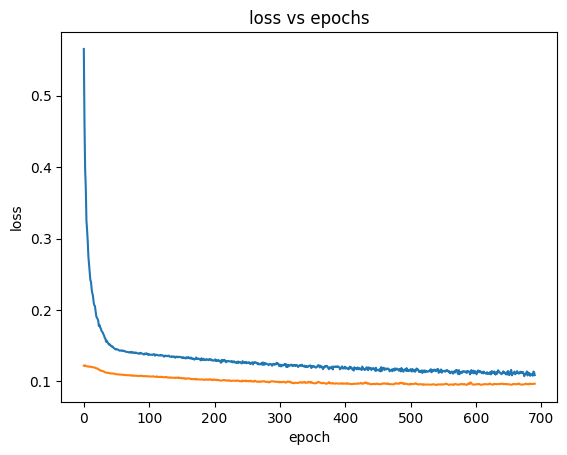

  1/158 [..............................] - ETA: 22s

C:\Dev\ELTE_AI\matmod\models.py:344: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



158/158 [==============================] - 1s 3ms/step

NNRegressor:
MeanSquaredError: 56454.535156
RootMeanSquaredError: 237.601654
MeanAbsoluteError: 61.869015
R2: 0.192208
FitPercent: 10.122758
CosineSimilarity: 0.557529


In [149]:
model = NNRegressor()
result = model.train_and_test(training_data=df_train,
                     features=features,
                     testing_data=df_test,
                     targets=targets,
                     denorm=denorm,
                     dense_width=80,
                     dense_depth=3,
                     dense_shrink=.5,
                     dropout=.4)
regression_results.update({model.__class__.__name__: result})

We can see the model successfuly fit the data without overfitting. This tells us that the regularizations employed were effective.

In [150]:
res_df = pd.DataFrame.from_dict(regression_results)


In [151]:
res_df

,NaiveRegressor,LinearRegressor,RegularizedRegressor,GAM,NNRegressor
MeanSquaredError,69888.250633,63540.423712,65956.120214,59654.553947,56454.535156
RootMeanSquaredError,264.363860,252.072259,256.819236,244.242818,237.601654
MeanAbsoluteError,92.434392,91.686748,85.808038,94.710994,61.869015
R2,-0.000011,0.090818,0.056253,0.146420,0.192208
FitPercent,-0.000555,4.648972,2.853339,7.610604,10.122758
CosineSimilarity,0.329370,0.435327,0.400807,0.488918,0.557529


In [152]:
errors_relative = {col: (res_df[col].iloc[:3].values-res_df.iloc[:3,0].values)/res_df.iloc[:3,0].values*100 for col in res_df.columns}

df_errors_relative = pd.DataFrame.from_dict(errors_relative).set_index(res_df.index[:3])

In [153]:
metric_relative = {col: res_df[col][3:].values for col in res_df.columns}

df_metric= pd.DataFrame.from_dict(metric_relative).set_index(res_df.index[3:])

In [154]:
df_errors_relative

,NaiveRegressor,LinearRegressor,RegularizedRegressor,GAM,NNRegressor
MeanSquaredError,0.0,-9.082824,-5.626311,-14.642943,-19.221708
RootMeanSquaredError,0.0,-4.649501,-2.853879,-7.611117,-10.123247
MeanAbsoluteError,0.0,-0.808838,-7.168711,2.462938,-33.067105


In [155]:
df_metric

,NaiveRegressor,LinearRegressor,RegularizedRegressor,GAM,NNRegressor
R2,-0.000011,0.090818,0.056253,0.146420,0.192208
FitPercent,-0.000555,4.648972,2.853339,7.610604,10.122758
CosineSimilarity,0.329370,0.435327,0.400807,0.488918,0.557529


In [156]:
errors=df_errors_relative.columns

fig = go.Figure(data=[
    go.Bar(name=ind, x=errors, y=df_errors_relative.iloc[i,:]) for i,ind in enumerate(df_errors_relative.index)
])
# Change the bar mode
fig.update_layout(barmode='group', title_text='Relative Decrease In Different Errors', xaxis_title='Model', yaxis_title='Relative Decrease')
fig.show()

In [157]:
metrics=df_metric.columns

fig = go.Figure(data=[
    go.Bar(name=ind, x=metrics, y=df_metric.iloc[i,:]) for i,ind in enumerate(df_metric.index)
])
# Change the bar mode
fig.update_layout(barmode='group', title_text='Different Fit Metrics for the Models', xaxis_title='Model', yaxis_title='Fit Metric Value')
fig.show()

We can see from the above charts, that in this multiple regression problem, the Neural Network Regressor seems to have the best overall performance.

# 6. Modeling - Classification of Difficulty

In [158]:
# we need the original difficulties, not the normalized ones
df = pd.read_parquet('./data/l4d2_player_stats_final_cleaned.parquet')

First let's check the class balances.

In [159]:
px.histogram(df['difficulty']).update_layout(
    title='distribution of difficulty classes', bargap=0.2, xaxis = dict(
        tickmode = 'array',
        tickvals = [0, 1, 2, 3],
        ticktext = ['Easy', 'Normal', 'Advanced', 'Expert'])).update_layout(title_text='Class Balances', xaxis_title='Class', yaxis_title='Count')

We can see that the classes are quite unbalanced. Thic can cause difficulties for the models. Next let's check the correlations with the difficulty levels.

In [160]:
corrs_difficulty = df[all_features].corr()['difficulty'].sort_values(ascending=False)[1:]
corrs_difficulty

fire_axe_rate                  0.186656
katana_rate                    0.173770
machete_rate                   0.169622
average_rate_weapon            0.109610
pump_shotgun_rate              0.093482
chrome_shotgun_rate            0.087234
hunting_rifle_usage            0.084288
tactical_shotgun_usage         0.078530
magnum_usage                   0.077765
magnum_rate                    0.069860
hunting_rifle_rate             0.065877
military_sniper_rifle_rate     0.063362
combat_shotgun_rate            0.061972
tactical_shotgun_rate          0.061728
combat_shotgun_usage           0.056856
military_sniper_rifle_usage    0.047055
average_rate_utility           0.046671
molotov_rate                   0.046671
max_rate_utility               0.046671
pump_shotgun_usage             0.029996
chrome_shotgun_usage           0.029018
chainsaw_rate                  0.018740
machete_usage                  0.017219
fire_axe_usage                 0.007630
ak_47_usage                   -0.010371


In [161]:
px.bar(corrs_difficulty).update_layout(
    xaxis_title='feature', yaxis_title='correlation', title='Correlations With Difficulty')

The values are still pretty low, but a bit higher than for playtime. We can include all features for modeling, since there are no obvious correlations. Let's normalize the dataset and try fitting some models!

In [162]:
features = list(set(all_features).difference({'difficulty'}))
df, *denorm = normalize(df, features, 'playtime')
df_train, df_test = split_data(df, .75)

In [163]:
targets = ['difficulty']
num_classes = 4

In [164]:
classification_results = {}

### a) Naive Model
Again, we set the baseline using a naive model. The NaiveClassifier is implemented, so it outputs a random class for every element of y_pred sampled with uniform distribution. All the ClassifierModel-s take a constructor argument which is the number of classes: num_classes.


NaiveClassifier:
Accuracy: 0.254520
F1Score: 0.275664


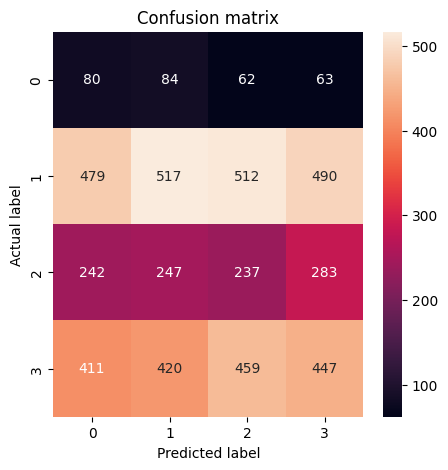

In [165]:
model = NaiveClassifier(num_classes)
result = model.train_and_test(df_train,
                               df_test,
                               features,
                               targets,
                               verbose=True)
classification_results.update({model.__class__.__name__: result})

As we expect, the naive model has terrible performance, only guessing the right class about 25% of the time.

### a) Naive Model
Now we employ increasingly complex models, starting with a Support Vector Classifier. We set a radial kernel function and a regularization coefficient of 1.5, which should not be too high but is higher than the default 1.0. This can be beneficial for a high dimensinality input (e.g. lot of features, which we have).

C:\Dev\Anaconda\envs\elte_ai\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().




SVClassifier:
Accuracy: 0.503676
F1Score: 0.440568


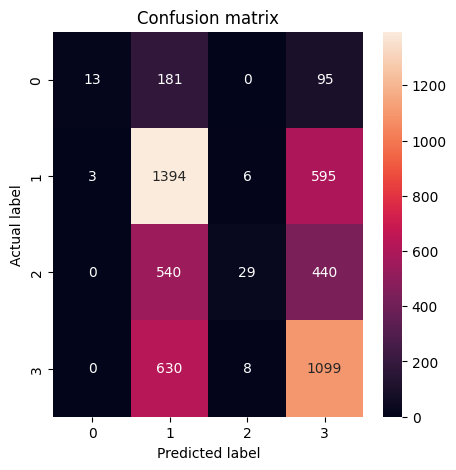

In [166]:
model = SVClassifier(num_classes)
result = model.train_and_test(df_train,
                               df_test,
                               features,
                               targets,
                               verbose=True,
                               kernel='rbf',
                               C=1.5)
classification_results.update({model.__class__.__name__: result})

We can see, that the SVM achieved twice as good Accuracy and almost twice as good F1 score compared to the naive model. It can be seen on the confusion matrix, that it struggles with the underrepresented classes though.

### d) Decision Tree
Next, we will train and test a decision tree. The tree will have default parameters, so none of the number of nodes/leaves or depth is restricted.


DecisionTree:
Accuracy: 0.399563
F1Score: 0.401608


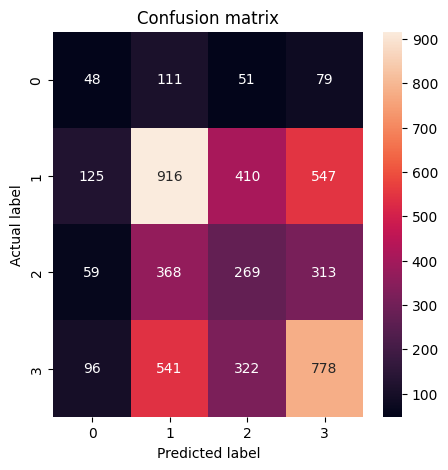

In [167]:
model = DecisionTree(num_classes)
result = model.train_and_test(df_train,
                               df_test,
                               features,
                               targets,
                               verbose=True)
classification_results.update({model.__class__.__name__: result})

In [168]:
print(f'Tree depth: {model.model.get_depth()}, Tree leaves: {model.model.get_n_leaves()}')


Tree depth: 33, Tree leaves: 3813


The bets fit resulted in a single tree with almost 4k leaves and a depth of 33 and achieved an Accuracy and F1 score of ~40%. This is worse than the SVM, but the tree could be fit much faster. We could start pruning the tree, but we should achieve better performance using more complex ensemble models.

### e) Random Forests
Next, let's train and test random forests with different number of max features. RFs can be fit a bit quicker than the SVM, so we can try different resitrictions on the number of features allowed at each split (m).

In [169]:
rf_m = {'m': [], 'acc': [], 'f1': []}
model = RandomForest(num_classes)
for m in tqdm.tqdm(range(1, len(features))):
    result = model.train_and_test(df_train,
                                  df_test,
                                  features,
                                  targets,
                                  verbose=False,
                                  max_features=m)
    rf_m['m'].append(m)
    rf_m['acc'].append(result['Accuracy'])
    rf_m['f1'].append(result['F1Score'])


  0%|          | 0/38 [00:00<?, ?it/s]C:\Dev\ELTE_AI\matmod\models.py:443: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

  3%|▎         | 1/38 [00:02<01:38,  2.67s/it]C:\Dev\ELTE_AI\matmod\models.py:443: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

  5%|▌         | 2/38 [00:07<02:27,  4.11s/it]C:\Dev\ELTE_AI\matmod\models.py:443: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

  8%|▊         | 3/38 [00:15<03:23,  5.81s/it]C:\Dev\ELTE_AI\matmod\models.py:443: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

 11%|█         | 4/38 [00:24<03:54,  6.90s/it]C:

In [170]:
fig = make_subplots(specs=[[{"secondary_y": True}]])

xs = rf_m['m']


fig.add_trace(
    go.Scatter(x=xs, y=rf_m['acc'], name='Accuracy', ),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=xs, y=rf_m['f1'], name='F1 Score', yaxis="y2"),
)

fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = xs,
        ticktext = [res[0] for res in results],
        title='number of allowed splits (m)'
    ),
        yaxis=dict(
        title="Accuracy",
    ),
    yaxis2=dict(
        title="F1 Score",
        side="right",
        autoshift=True,
    ),
    title='Scores vs m')

### f) Boosting
After trying parallel ensemble models, let's also try boosting; a sequential ensemble method. The boosting model is implemented using XGBoost, and we use the default parameters.


Boosting:
Accuracy: 0.495927
F1Score: 0.462808


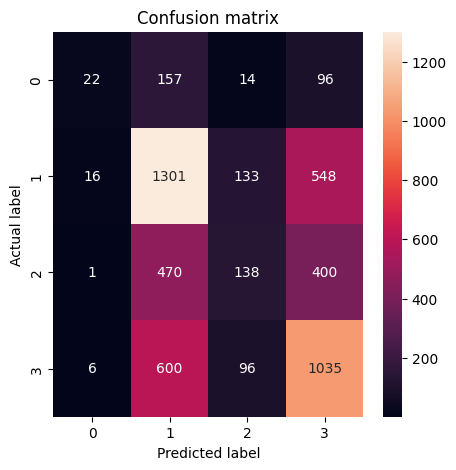

In [171]:
model = Boosting(num_classes)
result = model.train_and_test(df_train,
                               df_test,
                               features,
                               targets,
                               verbose=True)
classification_results.update({model.__class__.__name__: result})

The XGBoost model achieved better performance than the single decision tree, but had worse performance than the SVM and the Random Forest. With hyperparameter tuning, we could probably achieve better results.

Lastly, we train a similar neural network as for the regression task.

train samples: 15099
test samples: 5033
Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 39)]              0         
                                                                 
 dense_21 (Dense)            (None, 100)               4000      
                                                                 
 dropout_17 (Dropout)        (None, 100)               0         
                                                                 
 batch_normalization_17 (Bat  (None, 100)              400       
 chNormalization)                                                
                                                                 
 dense_22 (Dense)            (None, 50)                5050      
                                                                 
 dropout_18 (Dropout)        (None, 50)                0         
                   

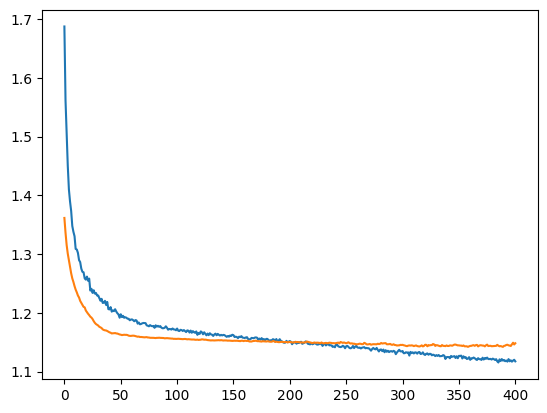

158/158 [==============================] - 1s 3ms/step

NNClassifier:
Accuracy: 0.502484
F1Score: 0.427649


C:\Dev\Anaconda\envs\elte_ai\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Dev\Anaconda\envs\elte_ai\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Dev\Anaconda\envs\elte_ai\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



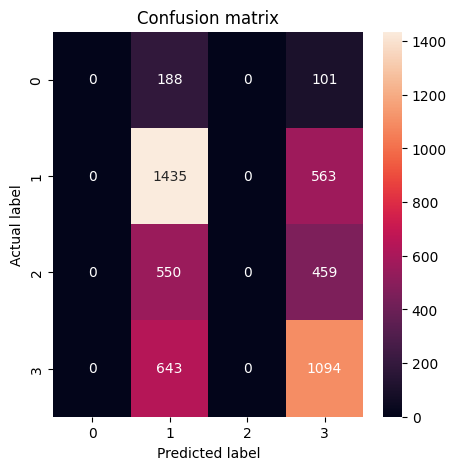

In [172]:
model = NNClassifier(num_classes=4)
model.train_and_test(training_data=df_train,
                     features=features,
                     testing_data=df_test,
                     targets=targets,
                     dense_width=100,
                     dense_depth=4,
                     dense_shrink=.5,
                     dropout=.4)
classification_results.update({model.__class__.__name__: result})

In [173]:
res_df_cls = pd.DataFrame.from_dict(classification_results)

res_df_cls


,NaiveClassifier,SVClassifier,DecisionTree,Boosting,NNClassifier
Accuracy,0.254520,0.503676,0.399563,0.495927,0.495927
F1Score,0.275664,0.440568,0.401608,0.462808,0.462808


In [174]:
errors = list(res_df_cls.columns)

fig = go.Figure(data=[
    go.Bar(name=ind, x=errors, y=res_df_cls.iloc[i,:]) for i,ind in enumerate(res_df_cls.index)
])
# Change the bar mode
fig.update_layout(barmode='group', title_text='Model Scores', xaxis_title='Model', yaxis_title='Score')
fig.show()